# Convolução

In [1]:
from skimage.exposure import rescale_intensity
import numpy as np
import matplotlib.pyplot as plt
import cv2

cv2 = opencv2  install pip opencv-python

In [54]:
img = plt.imread('../image/jarra.jpg')

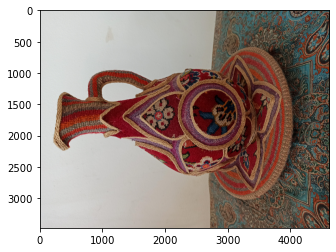

In [3]:
plt.imshow(img)

In [4]:
img.shape

(3472, 4624, 3)

In [5]:
img.shape[:2]

(3472, 4624)

In [6]:
(iH, iW) = img.shape[:2]

In [7]:
iH

3472

In [8]:
5//2

2

In [9]:
5/2

2.5

In [10]:
arr = np.array([1,2,3,4])

In [11]:
arr[1:-1]

array([2, 3])

In [13]:
np.arange(0,6)

array([0, 1, 2, 3, 4, 5])

In [15]:
def convolve(image, kernel):
    #image é prete-branco (grayscale)
    (iH, iW) = image.shape[:2]
    # iH= altura da imagem
    #iW = comprimento da imagem
    (kH,kW) = kernel.shape[:2]
    #kernel é uma matriz quadrada e a kW e kH são impares
    assert kW == kH and kW%2==1, 'o kernel deve ser quadrado'
    #assert kW%2==1, 'kernel deve ser impar'
    
    pad = (kW - 1)//2
    
    image_pad = np.zeros((iH+2*pad , iW+2*pad))
    image_pad[pad:-pad, pad:-pad] = image
    #image_pad = cv2.copyMakeBorder(image,pad,pad,pad,pad,
    #cv2.BORDER_REPLICATE)
    
    output = np.zeros((iH,iW), dtype = np.float32) #uint8
    
    for y in np.arange(pad, iH+pad):
        for x in np.arange(pad, iW+pad):
            #region of interest
            roi = image_pad[y-pad:y+pad+1, x- pad:x+pad+1]
            
            k = (roi*kernel).sum()
            
            output[y-pad,x-pad] = k
    
    output = rescale_intensity(output, in_range=(0,255))
    
    output = (output*255).astype(np.uint8)
    
    return output

In [61]:
smallBlur = np.ones((7, 7), dtype="float") * (1.0 / (7 * 7))
largeBlur = np.ones((21, 21), dtype="float") * (1.0 / (21 * 21))

# construct a sharpening filter
sharpen = np.array((
    [0, -1, 0],
    [-1, 5, -1],
    [0, -1, 0]), dtype="int")


#Emboss filter
emboss = np.array([[-2, -1, 0], 
                   [-1, 1, 1], 
                   [0, 1, 2]], dtype = 'int')

# construct the Laplacian kernel used to detect edge-like
# regions of an image
laplacian = np.array((
    [0, 1, 0],
    [1, -4, 1],
    [0, 1, 0]), dtype="int")

# construct the Sobel x-axis kernel
sobelX = np.array((
    [-1, 0, 1],
    [-2, 0, 2],
    [-1, 0, 1]), dtype="int")

# construct the Sobel y-axis kernel
sobelY = np.array((
    [-1, -2, -1],
    [0, 0, 0],
    [1, 2, 1]), dtype="int")

# construct the kernel bank, a list of kernels we're going
# to apply using our custom `convole` function 
kernelBank = (
    ("small_blur", smallBlur),
    ("large_blur", largeBlur),
    ("sharpen", sharpen),
    ("emboss", emboss),
    ("laplacian", laplacian),
    ("sobel_x", sobelX),
    ("sobel_y", sobelY)
)

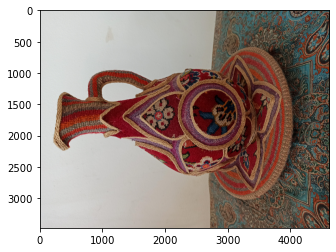

In [36]:
plt.imshow(img)

In [55]:
img = np.rot90(img, k=3)

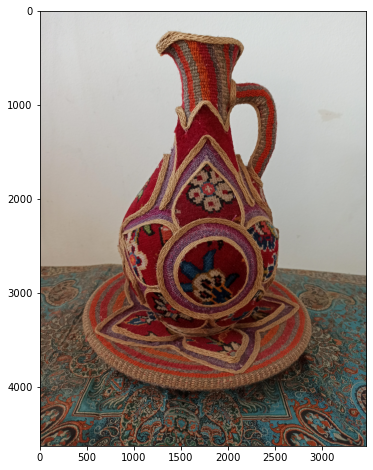

In [56]:
plt.figure(figsize=(10,8))
plt.imshow(img)

In [22]:
img.shape

(4624, 3472, 3)

In [57]:
dim = (img.shape[1]//8, img.shape[0]//8)
imagem = cv2.resize(img, dim)

In [58]:
imagem.shape

(578, 434, 3)

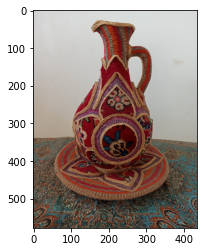

In [41]:
plt.imshow(imagem)

In [59]:
gray = cv2.cvtColor(imagem, cv2.COLOR_RGB2GRAY)

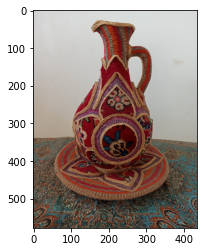

In [43]:
plt.imshow(imagem, cmap = 'gray')

In [44]:
i = convolve(imagem, sobelX)

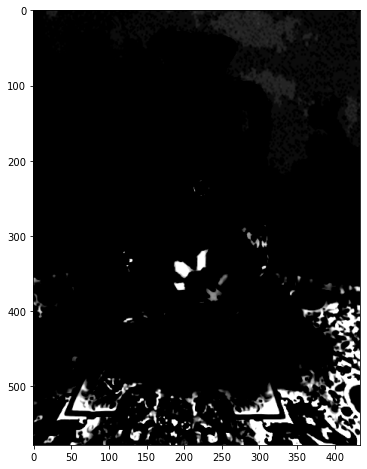

In [45]:
plt.figure(figsize=(10,8))

plt.imshow(i, cmap = 'gray')

In [46]:
img2 = plt.imread('../image/2.jpg')

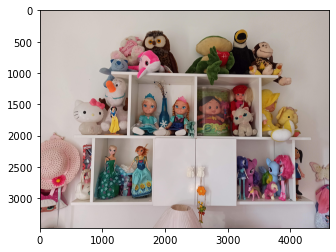

In [47]:
plt.imshow(img2)

In [49]:
dim = (img2.shape[1]//8, img2.shape[0]//8)
imagem2 = cv2.resize(img2, dim)

In [50]:
gray = cv2.cvtColor(imagem2, cv2.COLOR_RGB2GRAY)

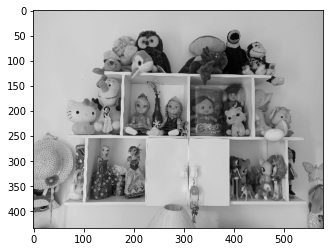

In [51]:
plt.imshow(gray, cmap = 'gray')

In [52]:
i = convolve(imagem2, sobelX)

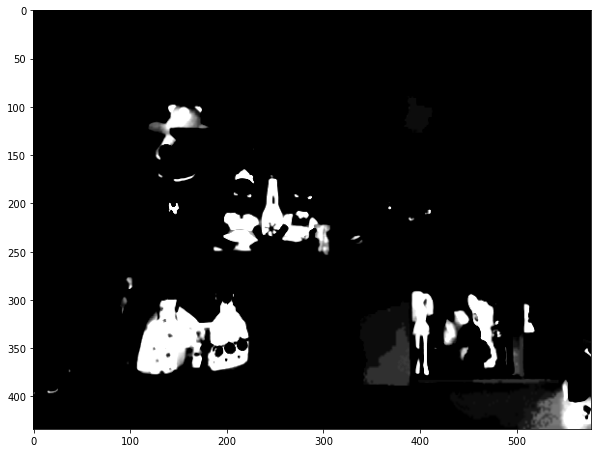

In [53]:
plt.figure(figsize=(10,8))

plt.imshow(i, cmap = 'gray')

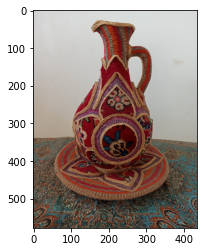

In [63]:
plt.imshow(imagem)

[INFO] applying small_blur kernel


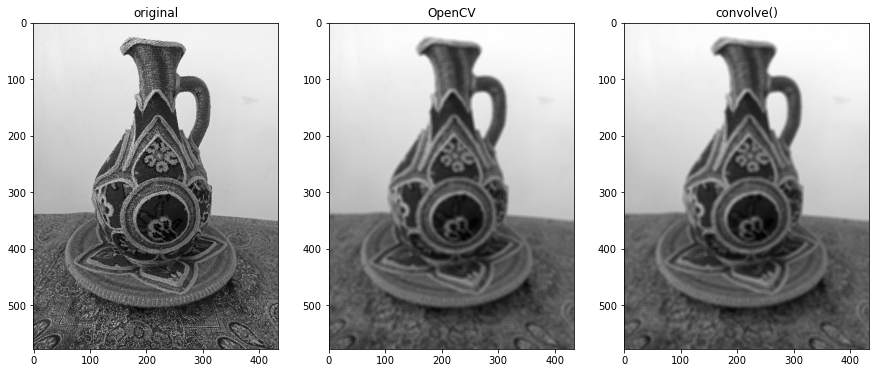

[INFO] applying large_blur kernel


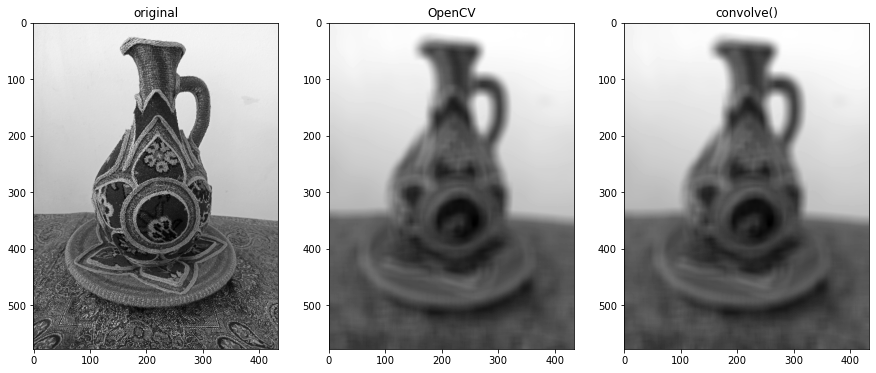

[INFO] applying sharpen kernel


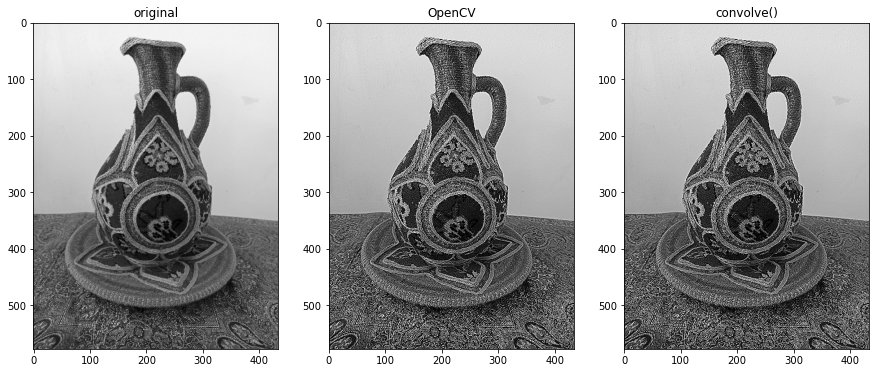

[INFO] applying emboss kernel


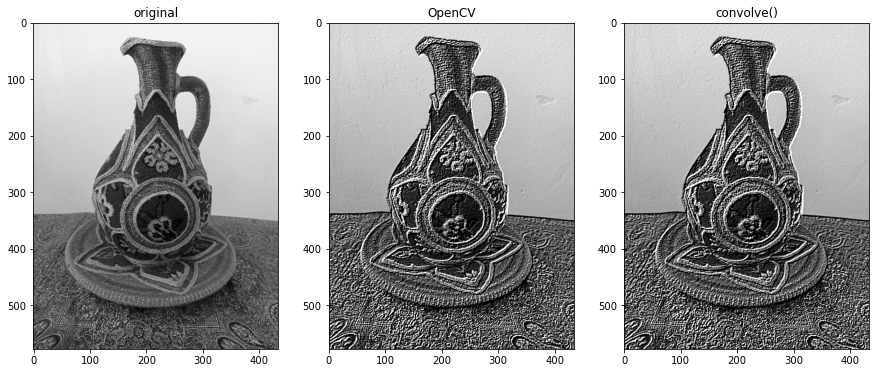

[INFO] applying laplacian kernel


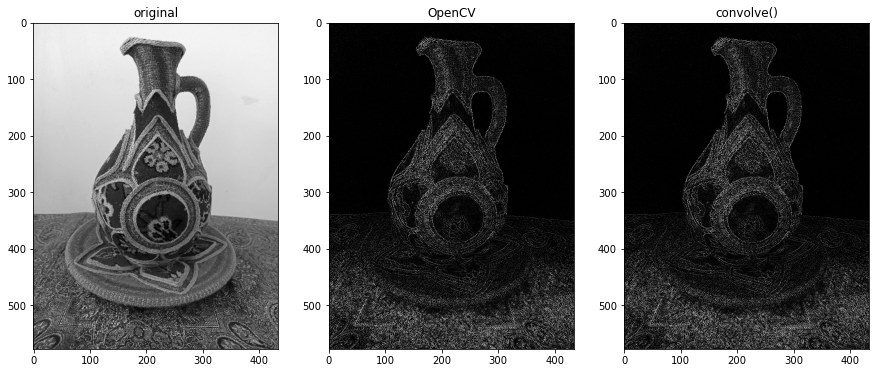

[INFO] applying sobel_x kernel


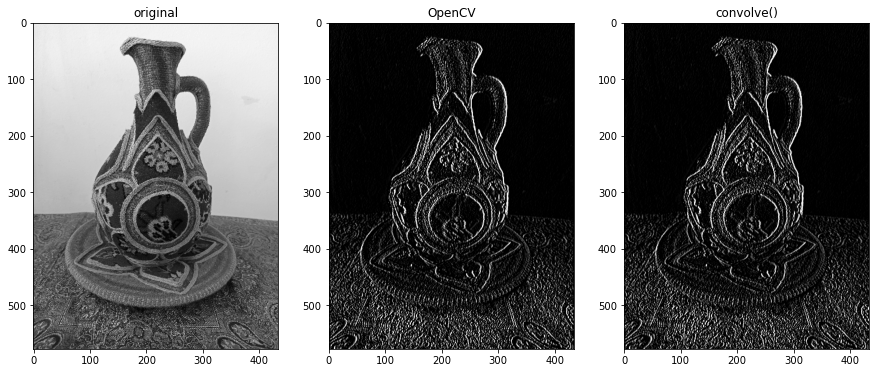

[INFO] applying sobel_y kernel


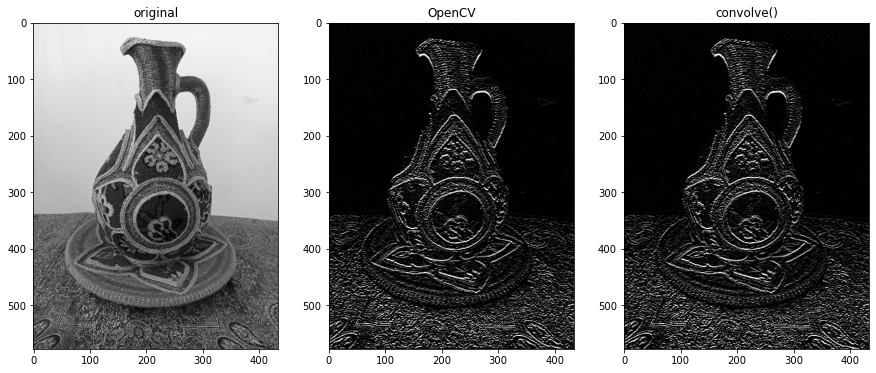

In [64]:
for (kernelName, kernel) in kernelBank:
    # apply the kernel to the grayscale image using
    # our custom `convole` function
    print(f"[INFO] applying {kernelName} kernel")
    convoleOutput = convolve(gray, kernel)
    convolveOpenCV = cv2.filter2D(gray,-1,kernel)
    
    plt.figure(figsize=(15,6))
    
    plt.subplot(131)
    plt.title('original')
    plt.imshow(gray, cmap='gray')
    
    plt.subplot(132)
    plt.title('OpenCV')
    plt.imshow(convolveOpenCV, cmap='gray')
    
    plt.subplot(133)
    plt.title('convolve()')
    plt.imshow(convoleOutput, cmap='gray')
    plt.show()

/home/vahid/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """


41.9 ms ± 8.41 ms per loop (mean ± std. dev. of 7 runs, 10 loops each)


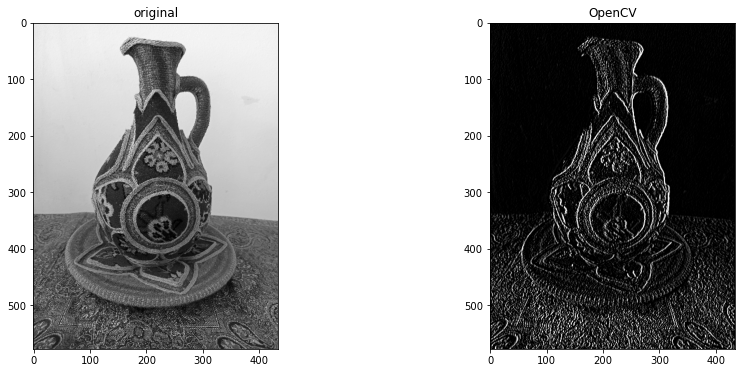

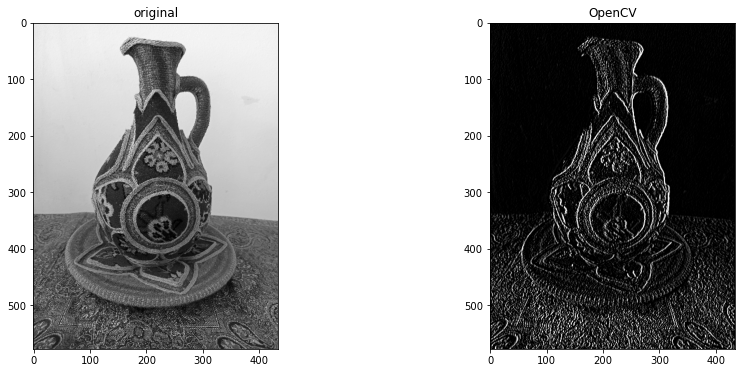

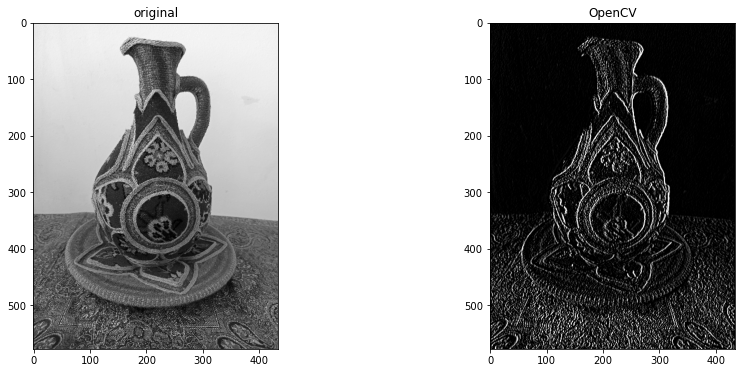

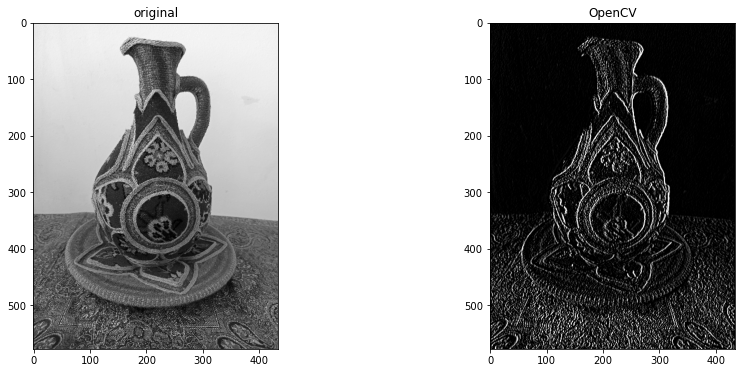

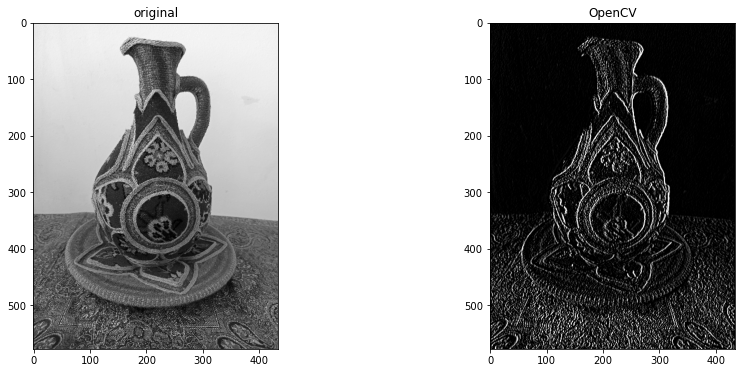

...

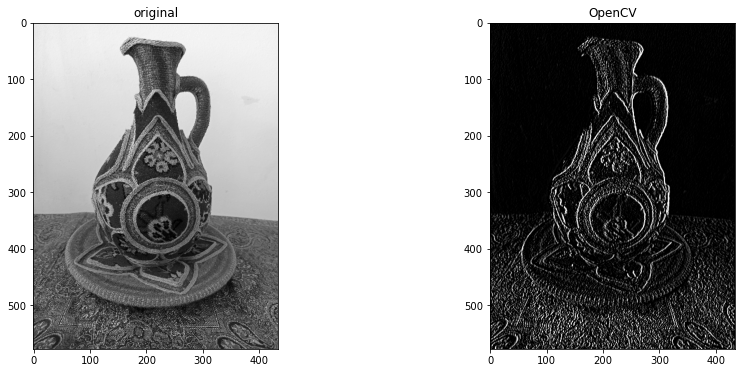

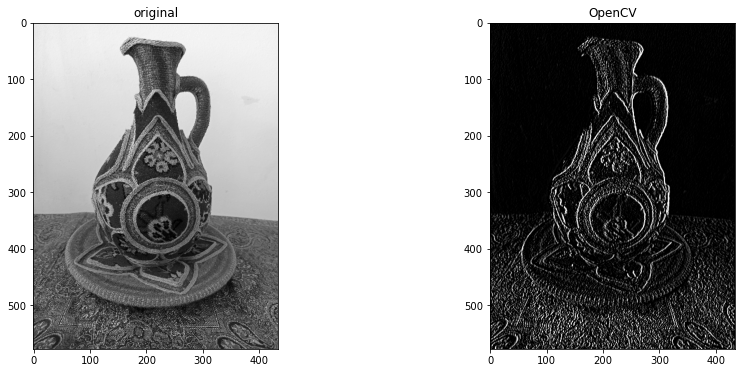

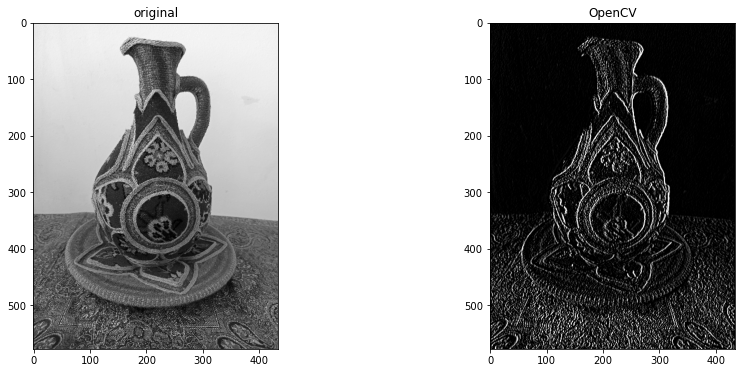

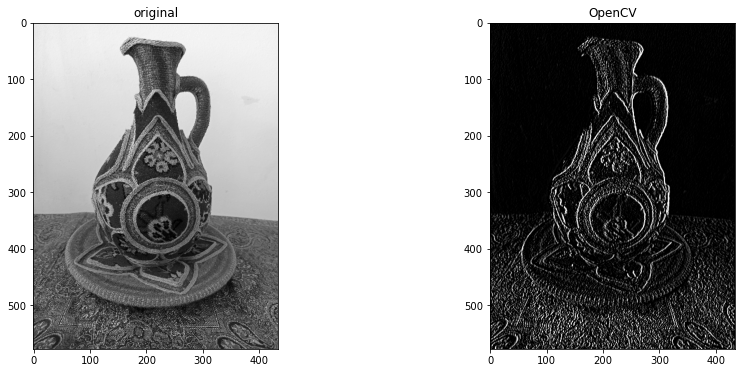

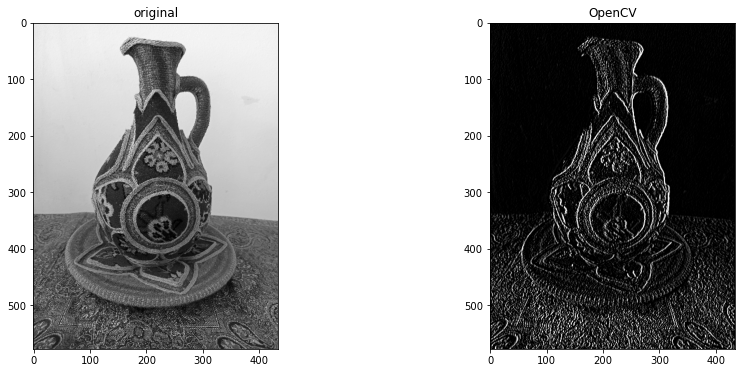

In [66]:
%%timeit

kernel = sobelX

convolveOpenCV = cv2.filter2D(gray,-1,kernel)

plt.figure(figsize=(15,6))

plt.subplot(121)
plt.title('original')
plt.imshow(gray, cmap='gray')

plt.subplot(122)
plt.title('OpenCV')
plt.imshow(convolveOpenCV, cmap='gray')


3.16 s ± 282 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


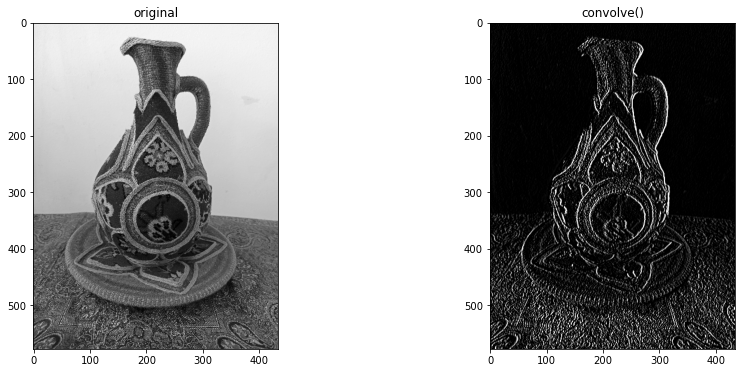

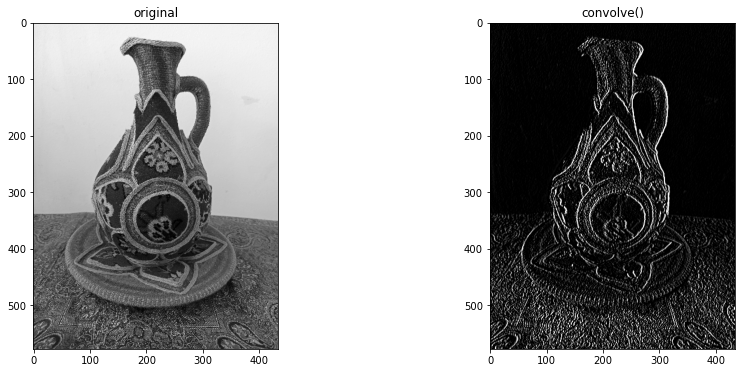

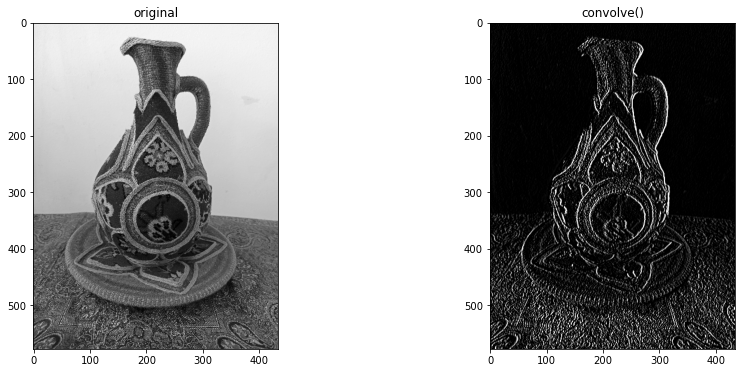

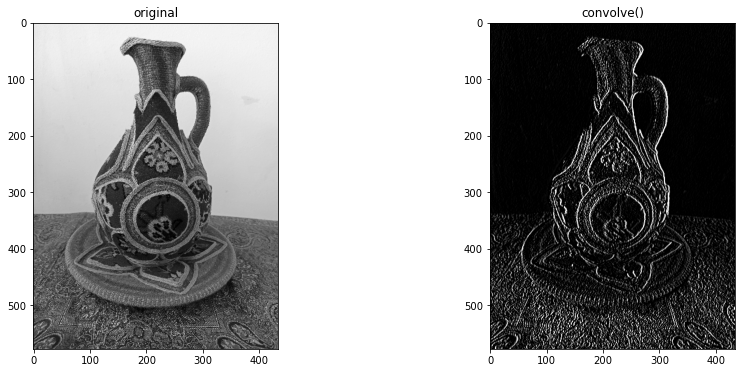

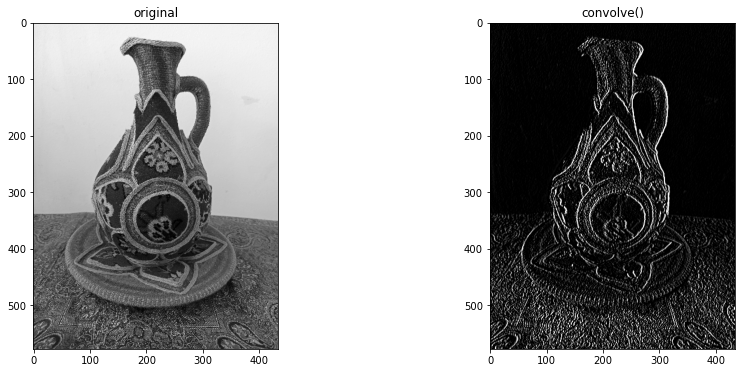

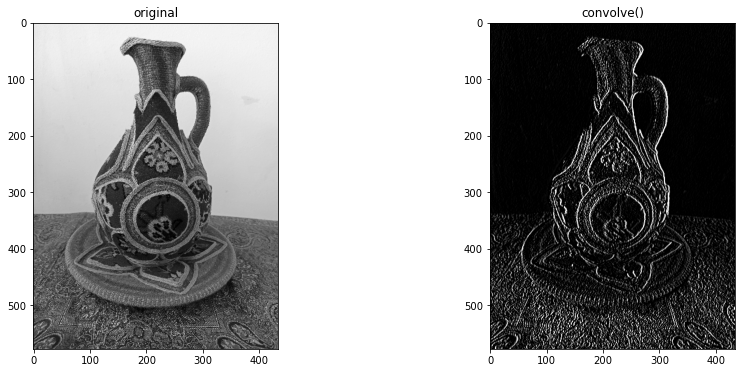

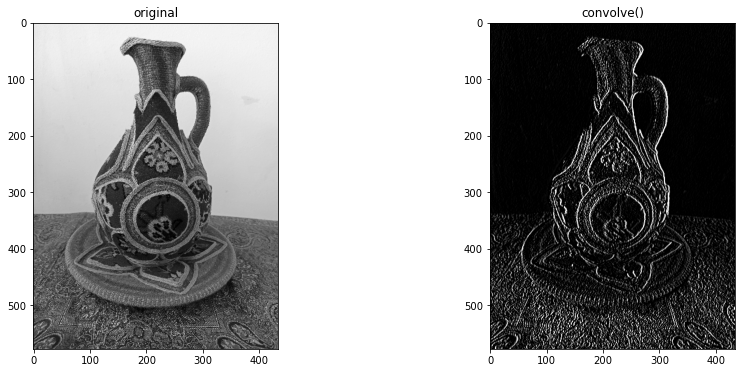

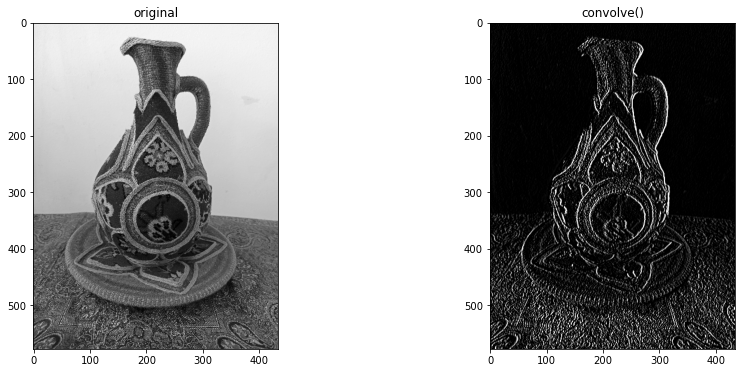

In [67]:
%%timeit

kernel = sobelX

convolveOutput = convolve(gray, kernel)

plt.figure(figsize=(15,6))

plt.subplot(121)
plt.title('original')
plt.imshow(gray, cmap='gray')

plt.subplot(122)
plt.title('convolve()')
plt.imshow(convolveOutput, cmap='gray')


In [68]:
3.16/(41.9 * 10*(-3))

-0.0025139220365950677

In [69]:
(41.9 * 10*(-3)) //3.16

-398.0